In [1]:
import magritte.core as magritte             # Core functionality
import magritte.plot as plot
import numpy as np
import os
import yt
import matplotlib.pyplot as plt
import matplotlib
from astropy import constants
from scipy.interpolate    import griddata           # Grid interpolation
from math                 import floor, ceil        # Math helper functions
import matplotlib.pyplot    as plt                  # Mpl plotting
from palettable.cubehelix import cubehelix2_16      # Nice colormap
import matplotlib.colors

from astropy import units

matplotlib.rc('font', family='serif')

from scipy.spatial import Delaunay, cKDTree   # Finding neighbors


#font for plots
import matplotlib

matplotlib.rcParams["font.family"] = "serif"
matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['font.family'] = 'STIXGeneral'

In [2]:
def image_channel(
        model,
        channels: list[int],
        figure_size: tuple[int, int], # (width, height), product should be equal to len(channels)
        image_nr   =  -1,
        zoom       = 1.3,
        npix_x     = 200,
        npix_y     = 200,
        x_unit     = units.au,
        v_unit     = units.km/units.s,
        method     = 'nearest',
        xticks     = None,
        yticks     = None,
        vmin       = None,
        vmax       = None,
):
    """Creates a single image of channel maps plotted next to each other, with the line profile below.

    Args:
        model (_type_): The Magritte model object.
        channels (list[int]): _description_
        figure_size (tuple[int, int]): _description_
        image_nr (int, optional): _description_. Defaults to -1.
        zoom (float, optional): _description_. Defaults to 1.3.
        npix_x (int, optional): _description_. Defaults to 300.
        npix_y (int, optional): _description_. Defaults to 300.
        x_unit (_type_, optional): _description_. Defaults to units.au.
        v_unit (_type_, optional): _description_. Defaults to units.km/units.s.
        method (str, optional): _description_. Defaults to 'nearest'.7
        xticks (list[float], optional): X axis ticks. Defaults to None.
        yticks (list[float], optional): Y axis ticks. Defaults to None.
        vmin (float, optional): Min value for the colorbar. Defaults to None.
        vmax (float, optional): Max value for the colorbar. Defaults to None.
    """
    if (len(model.images) < 1):
        print('No images in model.')
        return
    if (figure_size[0]*figure_size[1] != len(channels)):
        print('Figure size does not match number of channels.')
        return
    
    # Get path of image directory
    im_dir = os.path.dirname(os.path.abspath(model.parameters.model_name())) + '/images/'

    # If no image directory exists yet
    if not os.path.exists(im_dir):
        # Create image directory
        os.makedirs(im_dir)
        print('Created image directory:', im_dir)

    # Extract data of last image
    imx = np.array(model.images[image_nr].ImX)        
    imy = np.array(model.images[image_nr].ImY)
    imI = np.array(model.images[image_nr].I)

    # # Workaround for model images
    # if (model.images[image_nr].imagePointPosition == ImagePointPosition.AllModelPoints):
    #     # Filter imaging data originating from boundary points
    #     bdy_indices = np.array(model.geometry.boundary.boundary2point)
    #     imx = np.delete(imx, bdy_indices)
    #     imy = np.delete(imy, bdy_indices)
    #     imI = np.delete(imI, bdy_indices, axis=0)

    # Extract the number of frequency bins
    nfreqs = model.images[image_nr].nfreqs

    # Set image boundaries
    deltax = (np.max(imx) - np.min(imx))/zoom
    midx = (np.max(imx) + np.min(imx))/2.0
    deltay = (np.max(imy) - np.min(imy))/zoom
    midy = (np.max(imy) + np.min(imy))/2.0

    x_min, x_max = midx - deltax/2.0, midx + deltax/2.0
    y_min, y_max = midy - deltay/2.0, midy + deltay/2.0

    # Create image grid values
    xs = np.linspace(x_min, x_max, npix_x)
    ys = np.linspace(y_min, y_max, npix_y)

    # Extract the spectral / velocity data
    freqs = np.array(model.images[image_nr].freqs)
    f_ij  = np.mean(freqs)
    velos = (freqs - f_ij) / f_ij * constants.c.to(v_unit).value

    # Interpolate the scattered data to an image (regular grid)
    Is = np.zeros((nfreqs))
    zs = np.zeros((nfreqs, npix_x, npix_y))
    for f in range(nfreqs):
        # Nearest neighbor interpolate scattered image data
        zs[f] = griddata(
            (imx, imy),
            imI[:,f],
            (xs[None,:], ys[:,None]),
            method=method,
            fill_value = 0.0 #for non-nearest neighbor interpolation, otherwise the ceil/floor functions will complain
        )
        Is[f] = np.sum(zs[f])
    Is = Is / np.max(Is)

    # Put zero/negative values to the smallest positive value
    zs[zs<=0.0] = np.min(zs[zs>0.0])
    # Put nan values to smallest positive value
    zs[np.isnan(zs)] = np.min(zs[zs>0.0])

    # Get the logarithm of the data (matplotlib has a hard time handling logarithmic data.)
    log_zs     = np.log10(zs)
    log_zs_min = np.min(log_zs)
    log_zs_max = np.max(log_zs)

    # Set vmin and vmax for colorbar if not specified (and transform to log scale)
    if vmin is not None:
        log_zs_min = np.log10(vmin)
    if vmax is not None:
        log_zs_max = np.log10(vmax)
    
    # Set extend for colorbar
    if vmin is None:
        if vmax is None:
            extend = 'neither'
        else:
            extend = 'max'
    else:
        if vmax is None:
            extend = 'min'
        else:
            extend = 'both'
    
    print(vmin, vmax, log_zs_min, log_zs_max)

    lzmin = ceil (log_zs_min)
    lzmax = floor(log_zs_max)

    lz_25 = ceil (log_zs_min + 0.25*(log_zs_max - log_zs_min))
    lz_50 = ceil (log_zs_min + 0.50*(log_zs_max - log_zs_min))
    lz_75 = floor(log_zs_min + 0.75*(log_zs_max - log_zs_min))

    ticks  = [lzmin, lz_25, lz_50, lz_75, lzmax]
    levels = np.linspace(log_zs_min, log_zs_max, 250)

    colorbarwidth = 0.05
    lineprofileheight = 1.0

    fig = plt.figure(figsize = (1.5*(figure_size[1]+colorbarwidth),1.5*(figure_size[0]+lineprofileheight)), dpi=300)
    colorbarsplit = fig.subfigures(1,2, width_ratios=[1, colorbarwidth], wspace=-0.15)
    colorbarsplitrelevant = colorbarsplit[1].subfigures(2,1, height_ratios=[figure_size[1],lineprofileheight], hspace = 0, wspace = 0)
    colorbarax = colorbarsplitrelevant[0].subplots(1,1)
    subfigs = colorbarsplit[0].subfigures(2, 1, height_ratios=[figure_size[0], 1], hspace = 0.0)
    channelmapsfig = subfigs[0].subplots(figure_size[0], figure_size[1], sharex=True, sharey=True)
    subfigs[0].subplots_adjust(wspace = 0.05, hspace = 0.05)
    if type(channelmapsfig)==np.ndarray:
        channelmapsfig = channelmapsfig.flatten()
    lineprofilefig = subfigs[1].subplots(1, 1)

    for f in range(len(channels)):
        im = channelmapsfig[f].contourf(
            xs / (1.0 * x_unit).si.value,
            ys / (1.0 * x_unit).si.value,
            log_zs[channels[f]],
            cmap=cubehelix2_16.mpl_colormap,
            levels=levels,
            vmin=log_zs_min,
            vmax=log_zs_max,
            extend = extend
        )
        lineprofilefig.axvline(velos[channels[f]], linestyle=':', color='r')
        channelmapsfig[f].text(0.07,0.07,f'{velos[channels[f]]:.2f} '+str(v_unit), transform = channelmapsfig[f].transAxes, color='white')
        if xticks is not None:
            channelmapsfig[f].set_xticks(xticks)
        if yticks is not None:
            channelmapsfig[f].set_yticks(yticks)

    #now also plot the line profile
    lineprofilefig.plot(velos, Is/max(Is))
    #and some indicators of the line profile
    # lineprofilefig.axvline(min(velos[channels]), color='r')
    # lineprofilefig.axvline(max(velos[channels]), color='r')
    # Comment from reviewer: remove the red outer lines
    subfigs[1].supxlabel(f'velocity [{str(v_unit)}]', y = -0.20)

    #also add the figure axes
    subfigs[0].supxlabel(f'X [{str(x_unit)}]', y = 0.03)
    subfigs[0].supylabel(f'Y [{str(x_unit)}]')
    # subfigs[0].axes[-1].tick_params(axis='x', rotation=90)
    subfigs[0].suptitle("Intensity [W m$^{-2}$ sr$^{-1}$ Hz$^{-1}$]", y = 0.95)
    subfigs[1].suptitle("Relative intensity", y = 1.01)
    # Fix the colorbar ticks, as we plot the logarithm of the data
    cbar = fig.colorbar(im, cax=colorbarax)
    cbarticks = np.arange(lzmin, lzmax+1)
    # cbarlabels = [t.get_text().replace('−','-') for t in cbar.ax.get_yticklabels()]
    # cbarlabels = ticks
    cbar.ax.set_yticks(cbarticks)
    labels = [r"$10^{"+str(t)+"}$" for t in cbarticks]#better formatting
    cbar.ax.set_yticklabels(labels)
    # cbar.ax.set_yticklabels([f'{10**float(str(t)):.0e}' for t in cbarticks])

    return fig

Define file locations for importing all computed models (you will need to change the working directory) 

In [3]:
wdir = "/STER/thomasc/Magritte_Paper_Astronomy_Computing/models/Phantom_3D/"
J_file_original = os.path.join(wdir, 'J_original_full_NLTE.npy')
J_file_haar = os.path.join(wdir, 'J_haar_full_NLTE.npy')
J_file_gmsh = os.path.join(wdir, 'J_gmsh_full_NLTE.npy')
J_file_rec = os.path.join(wdir, 'J_rec_full_NLTE.npy')
model_file_haar = os.path.join(wdir, 'wind_red_haar.hdf5')   # reduced 3D Phantom Magritte model
model_file_gmsh = os.path.join(wdir, 'wind_red_gmsh.hdf5')   # reduced 3D Phantom Magritte model
model_file_rec = os.path.join(wdir, 'wind_red_rec.hdf5')   # reduced 3D Phantom Magritte model
model_file_original = os.path.join(wdir, 'model_Phantom_3D.ihdf5')   # original 3D Phantom Magritte model

#model files with 10 NLTE iterations
model_file_gmsh_save = os.path.join(wdir, 'wind_red_gmsh_save.hdf5')   # reduced 3D Phantom Magritte model
model_file_rec_save = os.path.join(wdir, 'wind_red_rec_save.hdf5')   # reduced 3D Phantom Magritte model
model_file_original_save = os.path.join(wdir, 'model_Phantom_3D_save.hdf5')   # original 3D Phantom Magritte model

In [4]:
#test whether the NLTE models are saved correctly
NLTE_model_gmsh = magritte.Model(model_file_gmsh_save)
NLTE_model_rec = magritte.Model(model_file_rec_save)
NLTE_model_original = magritte.Model(model_file_original_save)



                                           
-------------------------------------------
  Reading Model...                         
-------------------------------------------
 model file = /STER/thomasc/Magritte_Paper_Astronomy_Computing/models/Phantom_3D/wind_red_gmsh_save.hdf5
-------------------------------------------
Reading parameters...
Reading points...
Reading rays...
Reading boundary...
Reading chemistry...
Reading species...
Reading thermodynamics...
Reading temperature...
Reading turbulence...
Reading lines...
Reading lineProducingSpecies...
Reading linedata...
read num 1
read sym CO
nlev = 41
nrad = 40
Reading collisionPartner...
Reading collisionPartner...
Reading quadrature...
Reading radiation...
Reading frequencies...
Not using scattering!
                                           
-------------------------------------------
  Model read, parameters:                  
-------------------------------------------
  npoints    = 91960
  nrays      = 48
  nboundary  = 47

In [5]:
#common parameters for creating images from the different models
fcen = NLTE_model_original.lines.lineProducingSpecies[0].linedata.frequency[1]
# vpix = 1500   # velocity pixel size [m/s]
# dd   = vpix * (NLTE_model_original.parameters.nquads()-1)/2 / magritte.CC
maxvel = 25000#[m/s]
dd   = maxvel / magritte.CC
fmin = fcen - fcen*dd
fmax = fcen + fcen*dd

NLTE_model_gmsh.compute_spectral_discretisation ()
NLTE_model_gmsh.compute_inverse_line_widths     ()
#the codebase currently does not save line opacities and emissivities, so I do need to call this manually
NLTE_model_gmsh.lines.set_emissivity_and_opacity()

NLTE_model_rec.compute_spectral_discretisation ()
NLTE_model_rec.compute_inverse_line_widths     ()
NLTE_model_rec.lines.set_emissivity_and_opacity()

NLTE_model_original.compute_spectral_discretisation ()
NLTE_model_original.compute_inverse_line_widths     ()
NLTE_model_original.lines.set_emissivity_and_opacity()

Computing spectral discretisation...
Computing inverse line widths...
Computing spectral discretisation...
Computing inverse line widths...
Computing spectral discretisation...
Computing inverse line widths...


In [6]:
NLTE_model_gmsh.compute_spectral_discretisation (fmin, fmax, 121)#bins using the specified amount of frequency bins (31). Can be any integer >=1
# NLTE_model_gmsh.compute_image_new               (NLTE_model_gmsh.parameters.hnrays()-1, 512, 512)#using a resolution of 512x512 for the image.
NLTE_model_gmsh.compute_image_new               (0.0,0.0,1.0, 512, 512)#using a resolution of 512x512 for the image.

NLTE_model_rec.compute_spectral_discretisation (fmin, fmax, 121)#bins using the specified amount of frequency bins (31). Can be any integer >=1
# NLTE_model_rec.compute_image_new               (NLTE_model_rec.parameters.hnrays()-1, 512, 512)#using a resolution of 512x512 for the image.
NLTE_model_rec.compute_image_new               (0.0,0.0,1.0, 512, 512)#using a resolution of 512x512 for the image.

NLTE_model_original.compute_spectral_discretisation (fmin, fmax, 121)#bins using the specified amount of frequency bins (31). Can be any integer >=1
# NLTE_model_original.compute_image_new               (NLTE_model_original.parameters.hnrays()-1, 512, 512)#using a resolution of 512x512 for the image.
NLTE_model_original.compute_image_new               (0.0,0.0,1.0, 512, 512)#using a resolution of 512x512 for the image.


Computing spectral discretisation...
Computing image new...
Computing spectral discretisation...
Computing image new...
Computing spectral discretisation...
Computing image new...


0

None None -17.49863227952569 -14.399393591408401


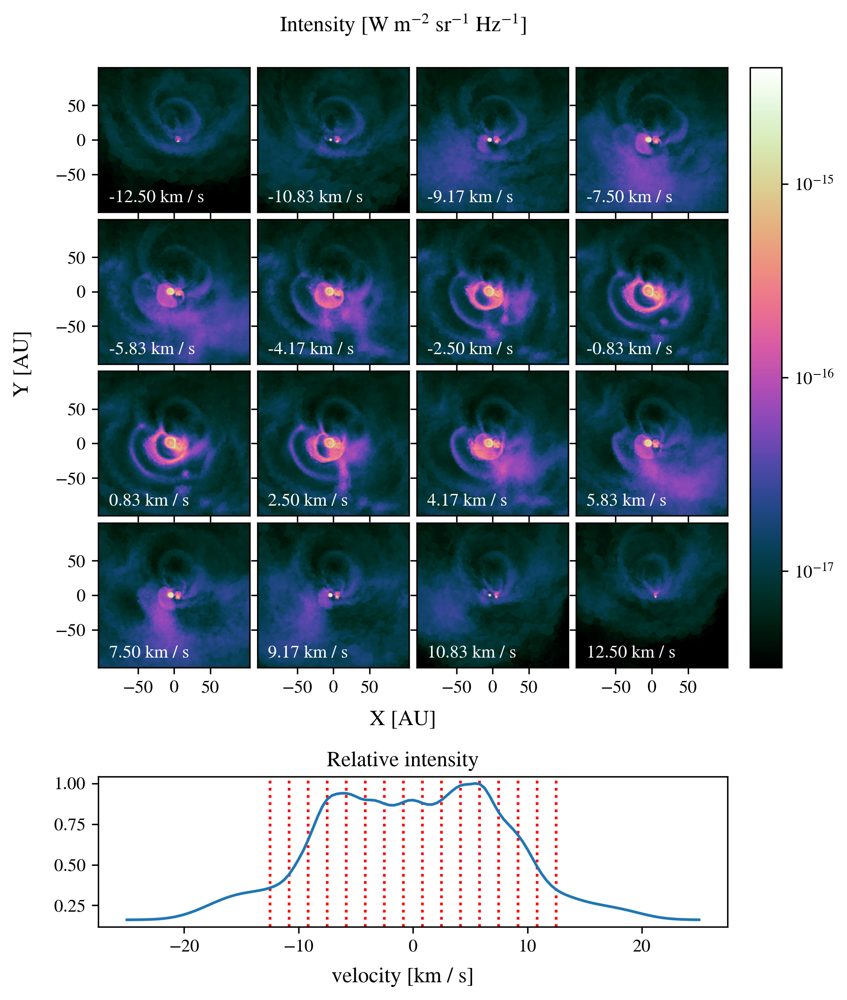

In [7]:
fig = image_channel(NLTE_model_gmsh,[30+4*i for i in range(16)], (4,4), zoom = 1.8, xticks=[-50,0,50], yticks=[-50,0,50], npix_x=512, npix_y=512)
fig.savefig("Images/gmsh_channel_map_combined.png", bbox_inches='tight')

None None -17.498636032377902 -14.448813848801606


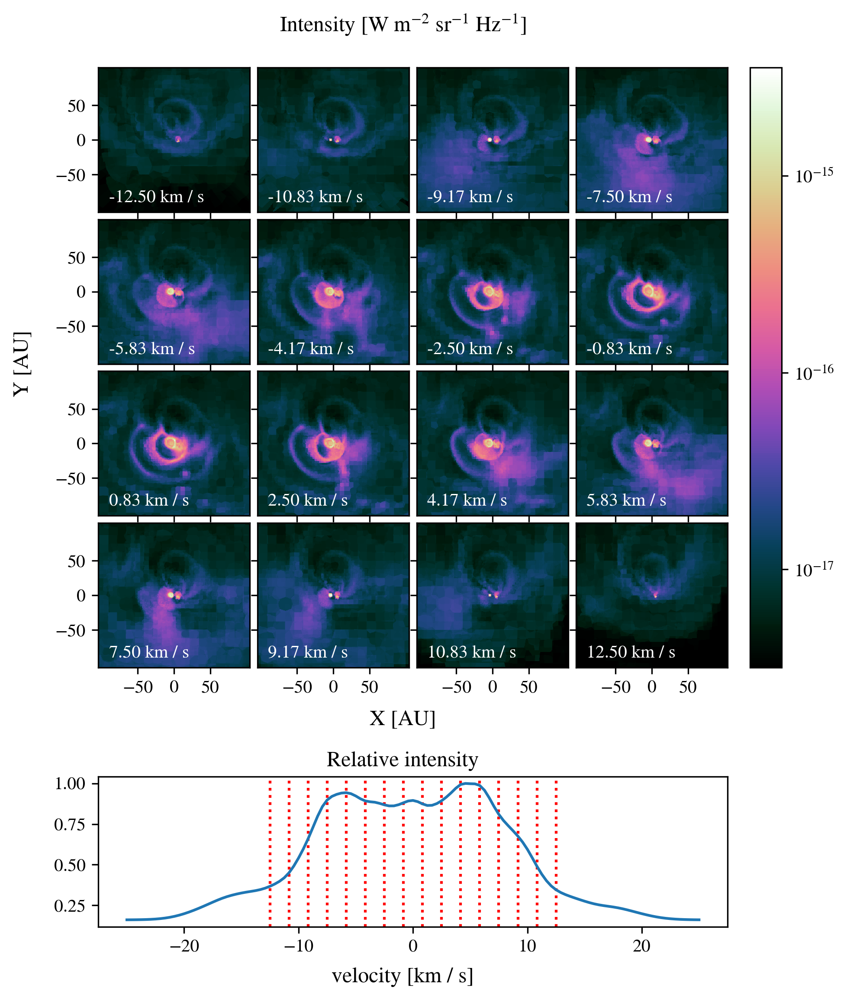

In [8]:
fig = image_channel(NLTE_model_rec,[30+4*i for i in range(16)], (4,4), zoom=1.8, xticks=[-50,0,50], yticks=[-50,0,50], npix_x=512, npix_y=512)
fig.savefig("Images/rec_channel_map_combined.png", bbox_inches='tight')

None None -17.498638486384213 -14.42798397820394


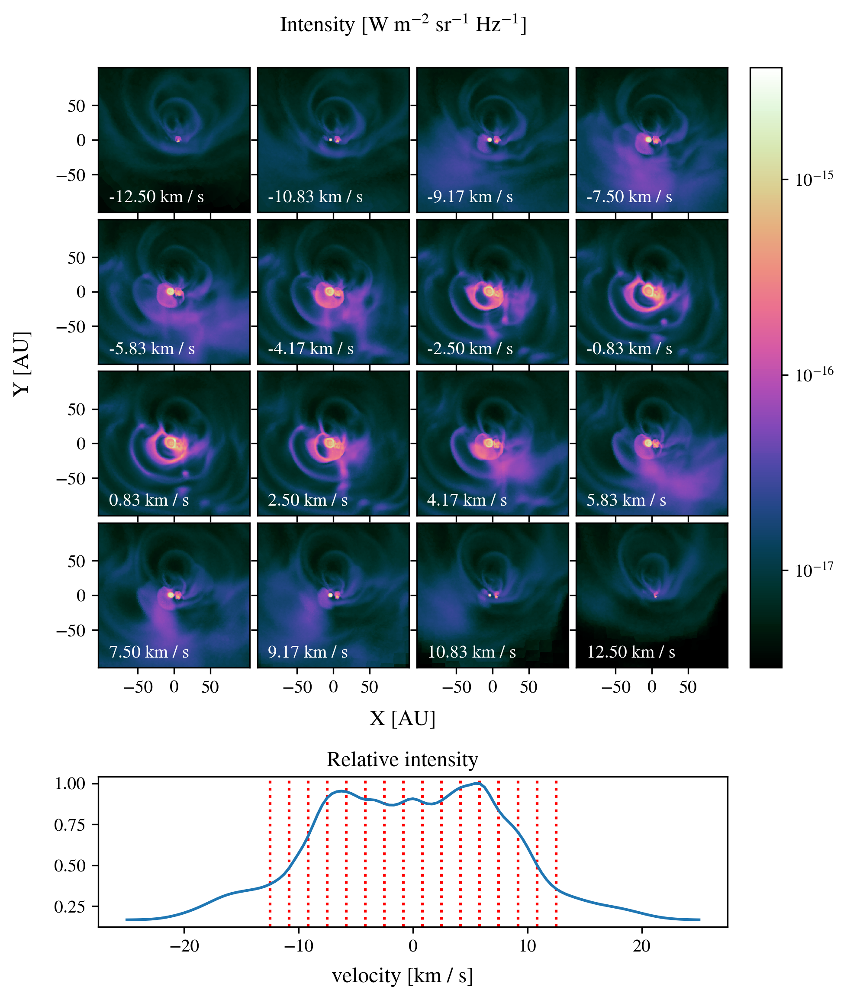

In [9]:
fig = image_channel(NLTE_model_original,[30+4*i for i in range(16)], (4,4), zoom=1.8, xticks=[-50,0,50], yticks=[-50,0,50], npix_x=512, npix_y=512)
fig.savefig("Images/original_channel_map_combined.png", bbox_inches='tight')

Loading the different saved J's for comparing them

In [10]:
# J_haar = np.load(J_file_haar)[:,1]
J_gmsh = np.load(J_file_gmsh)[:,1]
J_rec = np.load(J_file_rec)[:,1]
J_original = np.load(J_file_original)[:,1]

Obtain delaunay triangulations for showing the neighors structure (might take a few minutes for the original grid).

In [11]:
# position_haar = np.array(model_haar.geometry.points.position)
position_gmsh = np.array(NLTE_model_gmsh.geometry.points.position)
position_rec = np.array(NLTE_model_rec.geometry.points.position)
position_original = np.array(NLTE_model_original.geometry.points.position)
# delaunay_haar = Delaunay(position_haar)
delaunay_gmsh = Delaunay(position_gmsh)
delaunay_rec = Delaunay(position_rec)
delaunay_original = Delaunay(position_original)

Plot all computed J's

In [12]:
# ds_haar = yt.load_unstructured_mesh(
#     connectivity = delaunay_haar.simplices.astype(np.int64),
#     coordinates  = delaunay_haar.points.astype(np.float64) * 100.0, # yt expects cm not m 
#     node_data    = {('connect1', 'J'): J_haar[delaunay_haar.simplices].astype(np.float64)}
# )

In [13]:
# sl = yt.SlicePlot (ds_haar, 'z', ('connect1','J'))
# sl.set_cmap       (('connect1', 'J'), 'magma')
# sl.zoom           (1.1)

In [14]:
# ds_gmsh = yt.load_unstructured_mesh(
#     connectivity = delaunay_gmsh.simplices.astype(np.int64),
#     coordinates  = delaunay_gmsh.points.astype(np.float64) * 100.0, # yt expects cm not m 
#     node_data    = {('connect1', 'J'): J_gmsh[delaunay_gmsh.simplices].astype(np.float64)}
# )
# sl = yt.SlicePlot (ds_gmsh, 'z', ('connect1','J'))
# sl.set_cmap       (('connect1', 'J'), 'magma')
# sl.zoom           (1.1)

In [15]:
# ds_rec = yt.load_unstructured_mesh(
#     connectivity = delaunay_rec.simplices.astype(np.int64),
#     coordinates  = delaunay_rec.points.astype(np.float64) * 100.0, # yt expects cm not m 
#     node_data    = {('connect1', 'J'): J_rec[delaunay_rec.simplices].astype(np.float64)}
# )
# sl = yt.SlicePlot (ds_rec, 'z', ('connect1','J'))
# sl.set_cmap       (('connect1', 'J'), 'magma')
# sl.zoom           (1.1)

In [16]:
# ds_original = yt.load_unstructured_mesh(
#     connectivity = delaunay_original.simplices.astype(np.int64),
#     coordinates  = delaunay_original.points.astype(np.float64) * 100.0, # yt expects cm not m 
#     node_data    = {('connect1', 'J'): J_original[delaunay_original.simplices].astype(np.float64)}
# )
# sl = yt.SlicePlot (ds_original, 'z', ('connect1','J'))
# sl.set_cmap       (('connect1', 'J'), 'magma')
# sl.zoom           (1.1)

Project reduced computed data onto original data

In order to properly compare the computed mean intensities J on the different grids, we need to interpolate these results onto the original grid.

In [17]:
from scipy.interpolate import LinearNDInterpolator, NearestNDInterpolator
#nearest neighbor interpolation, as the linear does not seem to work for the haar mesh...
interp_func_J_gmsh = NearestNDInterpolator (position_gmsh, J_gmsh)
# interp_func_J_haar = NearestNDInterpolator (position_haar, J_haar)
interp_func_J_rec = NearestNDInterpolator (position_rec, J_rec)

In [18]:
# prj_J_haar_original = interp_func_J_haar(position_original)

In [19]:
prj_J_gmsh_original = interp_func_J_gmsh(position_original)

In [20]:
prj_J_rec_original = interp_func_J_rec(position_original)

After interpolating, compute the relative difference when compared to the original mesh

In [21]:
reldiff_gmsh_original_grid = 1.0/2.0*np.abs(prj_J_gmsh_original-J_original)/(prj_J_gmsh_original+J_original)
# reldiff_haar_original_grid = 1.0/2.0*np.abs(prj_J_haar_original-J_original)/(prj_J_haar_original+J_original)
reldiff_rec_original_grid = 1.0/2.0*np.abs(prj_J_rec_original-J_original)/(prj_J_rec_original+J_original)

In [22]:
# #Relative difference with gmsh re-mesh
# reldiff_original_gmsh = yt.load_unstructured_mesh(
#     connectivity = delaunay_original.simplices.astype(np.int64),
#     coordinates  = delaunay_original.points.astype(np.float64) * 100.0, # yt expects cm not m 
#     node_data    = {('connect1', 'J_reldiff'): reldiff_gmsh_original_grid[delaunay_original.simplices].astype(np.float64)}
# )
# sl = yt.SlicePlot (reldiff_original_gmsh, 'z', ('connect1','J_reldiff'))
# sl.set_cmap       (('connect1', 'J_reldiff'), 'magma')
# sl.set_zlim(('connect1', 'J_reldiff'), zmin=(1e-6, "1"), zmax=(4e-1, "1"))
# sl.zoom           (1.1)

In [23]:
# #Relative difference with haar re-mesh
# reldiff_original_gmsh = yt.load_unstructured_mesh(
#     connectivity = delaunay_original.simplices.astype(np.int64),
#     coordinates  = delaunay_original.points.astype(np.float64) * 100.0, # yt expects cm not m 
#     node_data    = {('connect1', 'J_reldiff'): reldiff_haar_original_grid[delaunay_original.simplices].astype(np.float64)}
# )
# sl = yt.SlicePlot (reldiff_original_gmsh, 'z', ('connect1','J_reldiff'))
# sl.set_cmap       (('connect1', 'J_reldiff'), 'magma')
# sl.set_zlim(('connect1', 'J_reldiff'), zmin=(1e-6, "1"), zmax=(4e-1, "1"))
# sl.zoom           (1.1)

In [24]:
# #Relative difference with recursive re-mesh
# reldiff_original_rec = yt.load_unstructured_mesh(
#     connectivity = delaunay_original.simplices.astype(np.int64),
#     coordinates  = delaunay_original.points.astype(np.float64) * 100.0, # yt expects cm not m 
#     node_data    = {('connect1', 'J_reldiff'): reldiff_rec_original_grid[delaunay_original.simplices].astype(np.float64)}
# )
# sl = yt.SlicePlot (reldiff_original_rec, 'z', ('connect1','J_reldiff'))
# sl.set_cmap       (('connect1', 'J_reldiff'), 'magma')
# sl.set_zlim(('connect1', 'J_reldiff'), zmin=(1e-6, "1"), zmax=(4e-1, "1"))
# sl.zoom           (1.1)

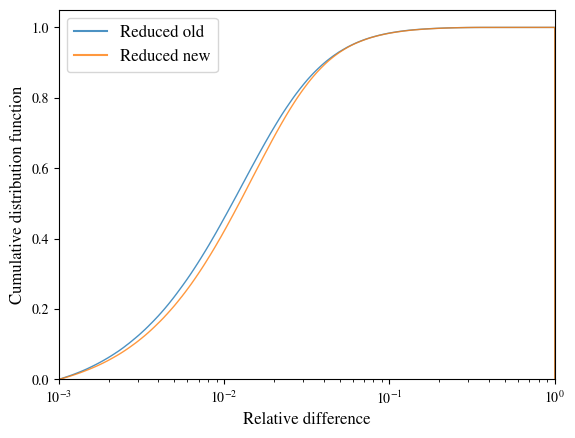

In [25]:
#Cumulative distribution of the relative differences of the computed J's
from matplotlib.lines import Line2D
fig = plt.figure()
ax = fig.add_subplot(111)
plt.hist(reldiff_gmsh_original_grid, cumulative=True, label='Reduced old', density=True,
         bins = len(reldiff_gmsh_original_grid), range=(1e-3, 1), histtype='step', alpha=0.8)
plt.hist(reldiff_rec_original_grid, cumulative=True, label='Reduced new', density=True,
         bins = len(reldiff_rec_original_grid), range=(1e-3, 1), histtype='step', alpha=0.8)
plt.xscale('log')
plt.xlim(1e-3,1.0)
plt.xlabel("Relative difference", fontsize="large")
plt.ylabel("Cumulative distribution function", fontsize="large")
handles, labels = ax.get_legend_handles_labels()
new_handles = [Line2D([], [], c=h.get_edgecolor()) for h in handles]

plt.legend(handles=new_handles, labels=labels, loc = "upper left", fontsize="large")
plt.savefig("relative_difference_plot.pdf")

In [26]:
#to find out which percentage of pixels are computed better than the given maximum relative error
print((reldiff_gmsh_original_grid.flatten() < 0.05).sum()/len(reldiff_gmsh_original_grid.flatten()))
print((reldiff_rec_original_grid.flatten() < 0.05).sum()/len(reldiff_rec_original_grid.flatten()))

0.9353282953294988
0.9330919175867907


In [27]:
I_gmsh = np.array(NLTE_model_gmsh.images[-1].I)
I_original = np.array(NLTE_model_original.images[-1].I)
I_rec = np.array(NLTE_model_rec.images[-1].I)

Out of interest, we can now also compare the line profiles

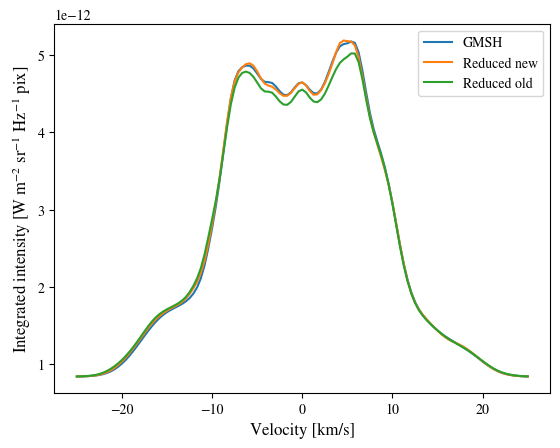

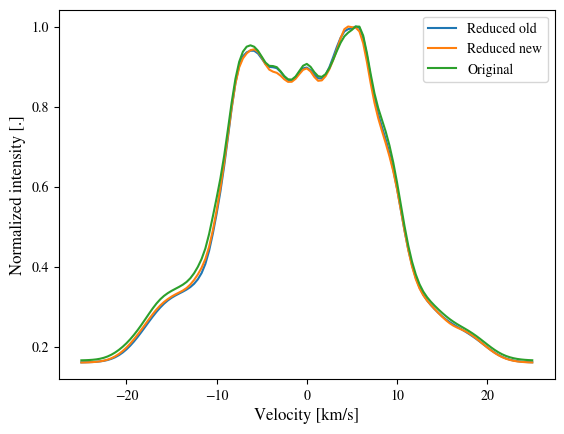

In [28]:
# Extract the spectral / velocity data
# For simplicity, I assume the frequency bins are the same for all images
freqs = np.array(NLTE_model_gmsh.images[-1].freqs)
f_ij  = np.mean(freqs)
v_unit = units.km / units.s
velos = (freqs - f_ij) / f_ij * constants.c.to(v_unit).value

# plot the line profiles of the visible pixels
# Interpolate the scattered data to an image (regular grid)
nfreqs = NLTE_model_gmsh.images[-1].nfreqs
npix_x = 512
npix_y = 512
zoom = 1.8
method = 'nearest'
imx = np.array(NLTE_model_gmsh.images[-1].ImX)
imy = np.array(NLTE_model_gmsh.images[-1].ImY)
imx_original = np.array(NLTE_model_original.images[-1].ImX)
imy_original = np.array(NLTE_model_original.images[-1].ImY)

# Set image boundaries
deltax = (np.max(imx) - np.min(imx))/zoom
midx = (np.max(imx) + np.min(imx))/2.0
deltay = (np.max(imy) - np.min(imy))/zoom
midy = (np.max(imy) + np.min(imy))/2.0

#Delta x and y for the original image
deltax_original = (np.max(imx_original) - np.min(imx_original))/zoom
midx_original = (np.max(imx_original) + np.min(imx_original))/2.0
deltay_original = (np.max(imy_original) - np.min(imy_original))/zoom
midy_original = (np.max(imy_original) + np.min(imy_original))/2.0

x_min, x_max = midx - deltax/2.0, midx + deltax/2.0
y_min, y_max = midy - deltay/2.0, midy + deltay/2.0

x_min_original, x_max_original = midx_original - deltax_original/2.0, midx_original + deltax_original/2.0
y_min_original, y_max_original = midy_original - deltay_original/2.0, midy_original + deltay_original/2.0

# Create image grid values
xs = np.linspace(x_min, x_max, npix_x)
ys = np.linspace(y_min, y_max, npix_y)

xs_original = np.linspace(x_min_original, x_max_original, npix_x)
ys_original = np.linspace(y_min_original, y_max_original, npix_y)

Is_gmsh = np.zeros((nfreqs))
Is_rec = np.zeros((nfreqs))
Is_original = np.zeros((nfreqs))
zs = np.zeros((nfreqs, npix_x, npix_y))
for f in range(nfreqs):
    # Nearest neighbor interpolate scattered image data
    zs[f] = griddata(
        (imx, imy),
        I_gmsh[:,f],
        (xs[None,:], ys[:,None]),
        method=method,
        fill_value = 0.0 #for non-nearest neighbor interpolation, otherwise the ceil/floor functions will complain
    )
    Is_gmsh[f] = np.sum(zs[f])
    zs[f] = griddata(
        (imx, imy),
        I_rec[:,f],
        (xs[None,:], ys[:,None]),
        method=method,
        fill_value = 0.0 #for non-nearest neighbor interpolation, otherwise the ceil/floor functions will complain
    )
    Is_rec[f] = np.sum(zs[f])
    zs[f] = griddata(
        (imx_original, imy_original),
        I_original[:,f],
        (xs_original[None,:], ys_original[:,None]),
        method=method,
        fill_value = 0.0 #for non-nearest neighbor interpolation, otherwise the ceil/floor functions will complain
    )
    Is_original[f] = np.sum(zs[f])
Is_gmsh_norm = Is_gmsh / np.max(Is_gmsh)
Is_rec_norm = Is_rec / np.max(Is_rec)
Is_original_norm = Is_original / np.max(Is_original)


# plot the line profiles of all three models
plt.plot(velos, Is_gmsh, label='GMSH')
plt.plot(velos, Is_rec, label='Reduced new')
plt.plot(velos, Is_original, label='Reduced old')
plt.xlabel("Velocity [km/s]", fontsize="large")
plt.ylabel("Integrated intensity [W m$^{-2}$ sr$^{-1}$ Hz$^{-1}$ pix]", fontsize="large")
plt.legend()

plt.figure()
plt.plot(velos, Is_gmsh_norm, label='Reduced old')
plt.plot(velos, Is_rec_norm, label='Reduced new')
plt.plot(velos, Is_original_norm, label='Original')
plt.xlabel("Velocity [km/s]", fontsize="large")
plt.ylabel("Normalized intensity [.]", fontsize="large")
plt.legend()


We will also compare the obtained images for the different meshes

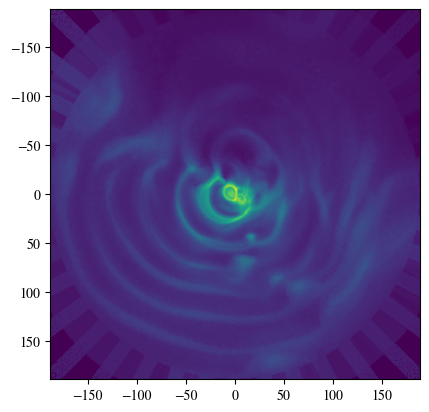

In [29]:
from astropy.constants import au
Nx = 512 #TODO: get automatically from image
Ny = 512
posx = NLTE_model_original.images[-1].ImX
posy = NLTE_model_original.images[-1].ImY
plt.imshow(I_original.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm())
plt.gca().invert_yaxis()

In [30]:
reldiff_image_original_rec = 2.0 * (np.abs(I_rec-I_original))/(I_rec+I_original)
reldiff_image_original_gmsh = 2.0 * (np.abs(I_gmsh-I_original))/(I_gmsh+I_original)

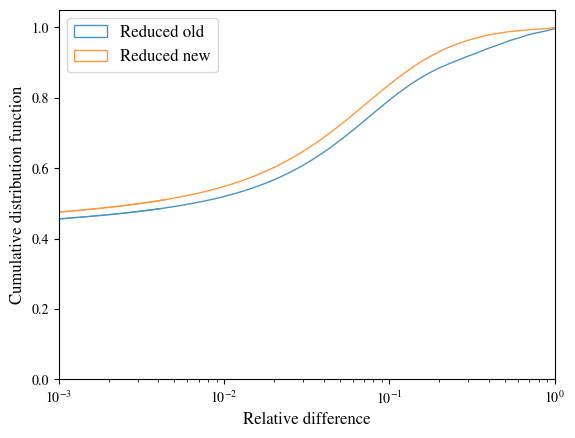

In [31]:
#Cumulative distribution of the relative differences of the intensities in the obtained images, per pixel, per frequency/channel map
plt.figure()
plt.xlim(1e-3,1e-0)
plt.hist(reldiff_image_original_gmsh.flatten(), cumulative=True, label='Reduced old', density=True,
         bins = len(reldiff_image_original_gmsh), histtype='step', alpha=0.8) 
plt.gca().set_xscale('log')

plt.hist(reldiff_image_original_rec.flatten(), cumulative=True, label='Reduced new', density=True,
         bins = len(reldiff_image_original_rec), histtype='step', alpha=0.8)
plt.legend(fontsize="large")
plt.xlabel("Relative difference", fontsize="large")
plt.ylabel("Cumulative distribution function", fontsize="large")
plt.savefig("relative_difference_image.pdf")
plt.show()

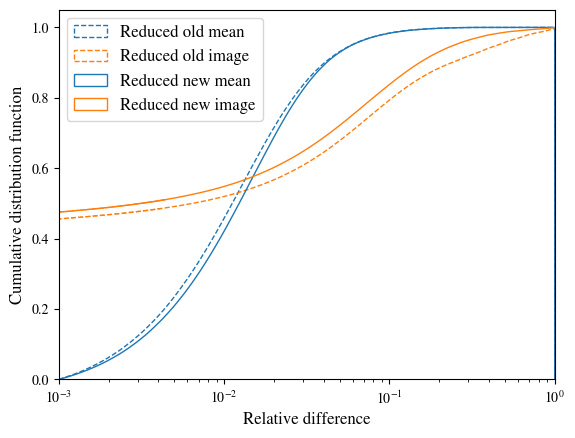

In [32]:
#Plotted both together
fig = plt.figure()
ax = fig.add_subplot(111)
plt.hist(reldiff_gmsh_original_grid, cumulative=True, label='Reduced old mean', density=True,
         bins = len(reldiff_gmsh_original_grid), range=(1e-3, 1), histtype='step', linestyle="dashed")

plt.hist(reldiff_image_original_gmsh.flatten(), cumulative=True, label='Reduced old image', density=True,
         bins = len(reldiff_image_original_gmsh), histtype='step', linestyle="dashed")
plt.gca().set_xscale('log')
plt.gca().set_prop_cycle(None)

plt.hist(reldiff_rec_original_grid, cumulative=True, label='Reduced new mean', density=True,
         bins = len(reldiff_rec_original_grid), range=(1e-3, 1), histtype='step', linestyle="solid")

plt.hist(reldiff_image_original_rec.flatten(), cumulative=True, label='Reduced new image', density=True,
         bins = len(reldiff_image_original_rec), histtype='step', linestyle="solid")
plt.xscale('log')
plt.xlim(1e-3,1.0)
plt.legend(fontsize="large")
plt.xlabel("Relative difference", fontsize="large")
# plt.legend(loc = "upper left", fontsize="large")
plt.ylabel("Cumulative distribution function", fontsize="large")
plt.savefig("relative_difference_J_and_image.pdf")
plt.show()

In [33]:
#to find out which percentage of pixels are computed better than the given maximum relative error
print((reldiff_image_original_gmsh.flatten() < 0.10).sum()/len(reldiff_image_original_gmsh.flatten()))
print((reldiff_image_original_rec.flatten() < 0.10).sum()/len(reldiff_image_original_rec.flatten()))

0.7937539471082451
0.8378273514676685


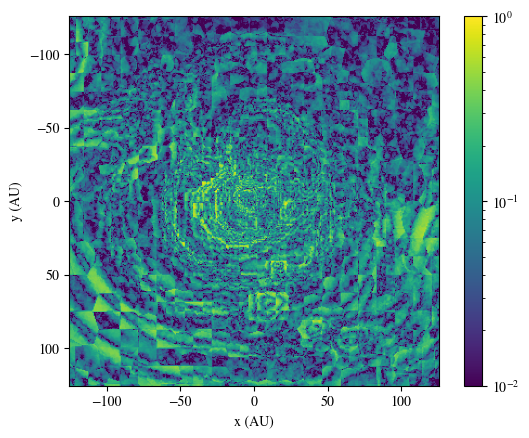

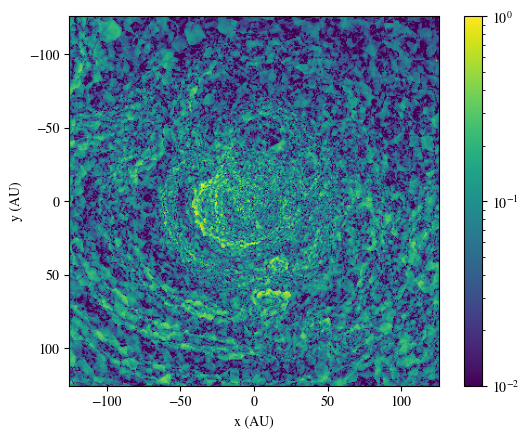

In [34]:
#Plot the relative differences for middle channel map
posx, posy = NLTE_model_original.images[-1].ImX, NLTE_model_original.images[-1].ImY
zoom = 1.5
#set bounds for colorbar
maxval = 1.0#max(np.max(reldiff_image_original_rec), np.max(reldiff_image_original_gmsh))
minval = 1e-2#lower than this value would be exaggerated

from astropy.constants import au

plt.figure()
plt.imshow(reldiff_image_original_rec.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm())
plt.colorbar()#err, limit colorbar to 10^-4; there is absolutely no point in going lower
plt.gca().invert_yaxis()#y axis should be flipped to correspond with the images
#zoom in 
minx, maxx = plt.gca().get_xlim()
miny, maxy = plt.gca().get_ylim()
midx, diffx = (minx+maxx)/2, (maxx-minx)/2
midy, diffy = (miny+maxy)/2, (maxy-miny)/2

ax = plt.gca()
ax.set_xlim([midx-diffx/zoom, midx+diffx/zoom])
ax.set_ylim([midy-diffy/zoom, midy+diffy/zoom])

plt.xlabel("x (AU)")
plt.ylabel("y (AU)")
plt.clim(minval, maxval)

plt.savefig("reldiff_image_original_rec.pdf")
plt.show()

plt.figure()
plt.imshow(reldiff_image_original_gmsh.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm())
plt.colorbar()
plt.gca().invert_yaxis()#y axis is wrong
#same zoom settings
ax = plt.gca()
ax.set_xlim([midx-diffx/zoom, midx+diffx/zoom])
ax.set_ylim([midy-diffy/zoom, midy+diffy/zoom])
plt.xlabel("x (AU)")
plt.ylabel("y (AU)")
plt.clim(minval, maxval)

plt.savefig("reldiff_image_original_gmsh.pdf")
plt.show()

In [35]:
# #and do the same for all channel maps
# for index in range(61):
#     posx, posy = NLTE_model_original.images[-1].ImX, NLTE_model_original.images[-1].ImY
#     zoom = 1.5
#     #set bounds for colorbar
#     maxval = max(np.max(reldiff_image_original_rec), np.max(reldiff_image_original_gmsh))
#     minval = 1e-4#lower than this value would be exaggerated

#     plt.figure()
#     plt.imshow(reldiff_image_original_rec.reshape(Nx, Ny, 61)[:,:,index].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm())
#     plt.colorbar()#err, limit colorbar to 10^-4; there is absolutely no point in going lower
#     plt.gca().invert_yaxis()#y axis is wrong
#     #zoom in 
#     minx, maxx = plt.gca().get_xlim()
#     miny, maxy = plt.gca().get_ylim()
#     midx, diffx = (minx+maxx)/2, (maxx-minx)/2
#     midy, diffy = (miny+maxy)/2, (maxy-miny)/2

#     ax = plt.gca()
#     ax.set_xlim([midx-diffx/zoom, midx+diffx/zoom])
#     ax.set_ylim([midy-diffy/zoom, midy+diffy/zoom])

#     plt.xlabel("x (AU)")
#     plt.ylabel("y (AU)")
#     plt.clim(minval, maxval)

#     plt.savefig("Images/reldiff_image_original_rec_"+str(index)+".pdf")

#     plt.figure()
#     plt.imshow(reldiff_image_original_gmsh.reshape(Nx, Ny, 61)[:,:,index].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm())
#     plt.colorbar()#err, limit colorbar to 10^-4; there is absolutely no point in going lower
#     plt.gca().invert_yaxis()#y axis is wrong
#     #same zoom settings
#     ax = plt.gca()
#     ax.set_xlim([midx-diffx/zoom, midx+diffx/zoom])
#     ax.set_ylim([midy-diffy/zoom, midy+diffy/zoom])
#     plt.xlabel("x (AU)")
#     plt.ylabel("y (AU)")
#     plt.clim(minval, maxval)

#     plt.savefig("Images/reldiff_image_original_gmsh_"+str(index)+".png")


Now, we also create some more images for the paper, combining the mesh, image at zero velocity, and the relative difference into a single image

yt : [INFO     ] 2024-07-26 09:49:05,337 Parameters: current_time              = 0.0
yt : [INFO     ] 2024-07-26 09:49:05,338 Parameters: domain_dimensions         = [2 2 2]
yt : [INFO     ] 2024-07-26 09:49:05,339 Parameters: domain_left_edge          = [-3.10381482e+13 -3.10381482e+13 -3.10036614e+13]
yt : [INFO     ] 2024-07-26 09:49:05,340 Parameters: domain_right_edge         = [3.10381482e+13 3.10381482e+13 3.10036614e+13]
yt : [INFO     ] 2024-07-26 09:49:05,342 Parameters: cosmological_simulation   = 0
yt : [INFO     ] 2024-07-26 09:49:05,923 xlim = -31038148184430.707031 31038148184430.707031
yt : [INFO     ] 2024-07-26 09:49:05,924 ylim = -31038148184430.707031 31038148184430.707031
yt : [INFO     ] 2024-07-26 09:49:05,927 xlim = -31038148184430.707031 31038148184430.707031
yt : [INFO     ] 2024-07-26 09:49:05,927 ylim = -31038148184430.707031 31038148184430.707031
yt : [INFO     ] 2024-07-26 09:49:05,932 Making a fixed resolution buffer of (('connect1', 'n')) 800 by 800


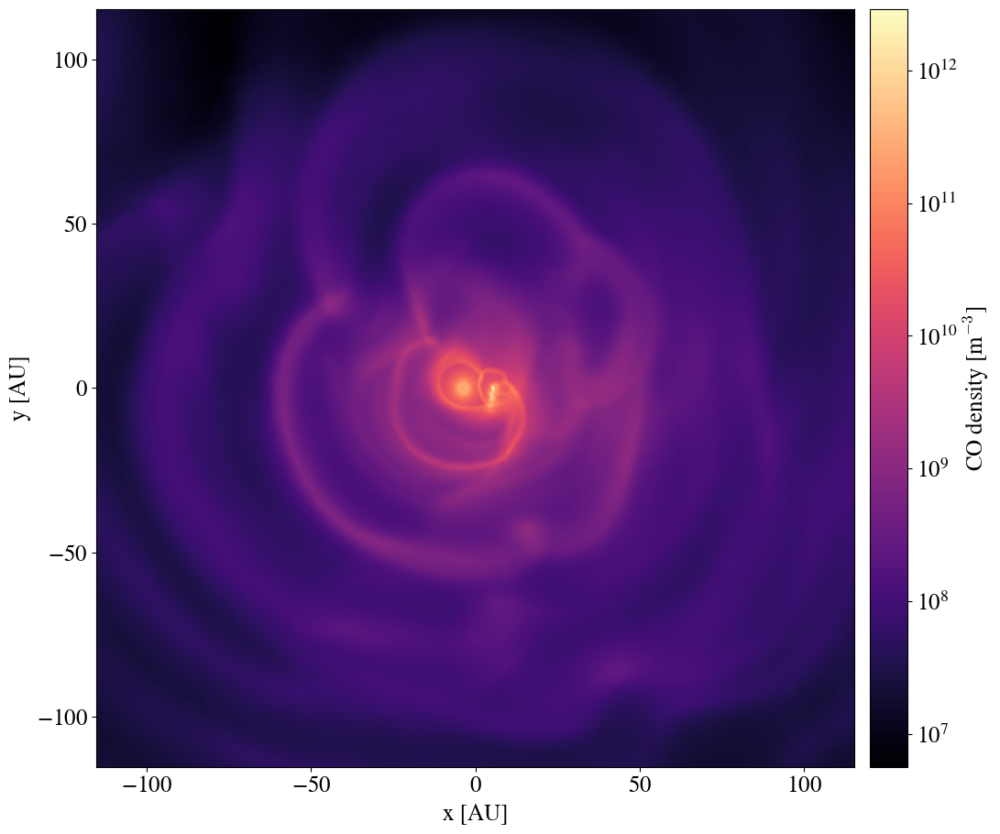

In [36]:
nCO_original = np.array(NLTE_model_original.chemistry.species.abundance)[:,1]
ds_gmsh = yt.load_unstructured_mesh(
         connectivity = delaunay_original.simplices.astype(np.int64),
         coordinates  = delaunay_original.points.astype(np.float64), # yt expects cm not m
         node_data    = {('connect1', 'n'): nCO_original[delaunay_original.simplices].astype(np.float64)/yt.units.m**3},
         length_unit='m'
)

#plotting the density of the original model seperately
sl = yt.SlicePlot (ds_gmsh, 'z', ('connect1', 'n'))
sl.set_cmap       (('connect1', 'n'), 'magma')
sl.zoom           (1.8)
sl.set_minorticks('all', 'off')
sl.set_background_color(('connect1', 'n'), 'black')
# sl.set_zlim(('connect1', 'n'), 1.0e-4, None)
mpl_fig = sl.export_to_mpl_figure((1,1), label_mode="ALL", cbar_pad="2%", cbar_mode='each', cbar_location='right')
mpl_fig.axes[0].set_ylabel('y [AU]')#replace round brackets with square ones
mpl_fig.axes[0].set_xlabel('x [AU]')
mpl_fig.axes[0].images[-1].colorbar.set_label('CO density [m$^{-3}$]')#same with the colorbar label
mpl_fig.axes[0].tick_params(axis='both', which='major', direction="out", top=False, right=False)
mpl_fig.axes[0].minorticks_off()
# and then fix the ticks in the colorbar
mpl_fig.axes[0].images[-1].colorbar.ax.tick_params(axis='both', which='both', direction="in", top=False, right=False, left=False, bottom=False)
mpl_fig.axes[0].images[-1].colorbar.ax.tick_params(axis='both', which='major', direction="out", top=False, right=True, left=False, bottom=False)


mpl_fig.tight_layout()
plt.savefig('Phantom_density.pdf', dpi=300)
#end plotting density

yt : [INFO     ] 2024-07-26 10:16:28,536 Parameters: current_time              = 0.0
yt : [INFO     ] 2024-07-26 10:16:28,537 Parameters: domain_dimensions         = [2 2 2]
yt : [INFO     ] 2024-07-26 10:16:28,538 Parameters: domain_left_edge          = [-3.11073526e+13 -3.11073526e+13 -3.11073526e+13]
yt : [INFO     ] 2024-07-26 10:16:28,539 Parameters: domain_right_edge         = [3.11073526e+13 3.11073526e+13 3.11073526e+13]
yt : [INFO     ] 2024-07-26 10:16:28,540 Parameters: cosmological_simulation   = 0
yt : [INFO     ] 2024-07-26 10:16:28,692 xlim = -31107352614123.035156 31107352614123.035156
yt : [INFO     ] 2024-07-26 10:16:28,693 ylim = -31107352614123.035156 31107352614123.035156
yt : [INFO     ] 2024-07-26 10:16:28,697 xlim = -31107352614123.035156 31107352614123.035156
yt : [INFO     ] 2024-07-26 10:16:28,698 ylim = -31107352614123.035156 31107352614123.035156
yt : [INFO     ] 2024-07-26 10:16:28,701 Making a fixed resolution buffer of (('connect1', 'n')) 800 by 800
yt :

min 2212972.9173191623 max 4911074390436.68 minco 2230799.604273411 maxco 4911074390436.68


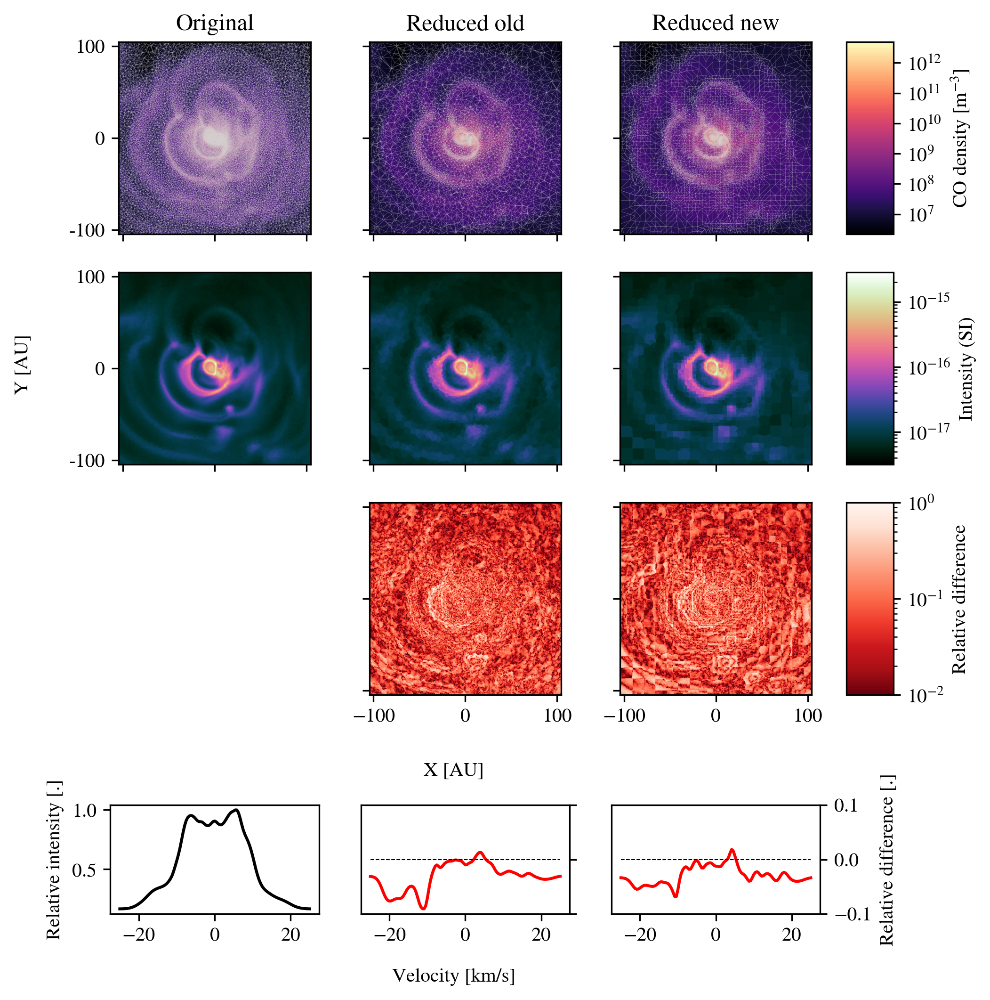

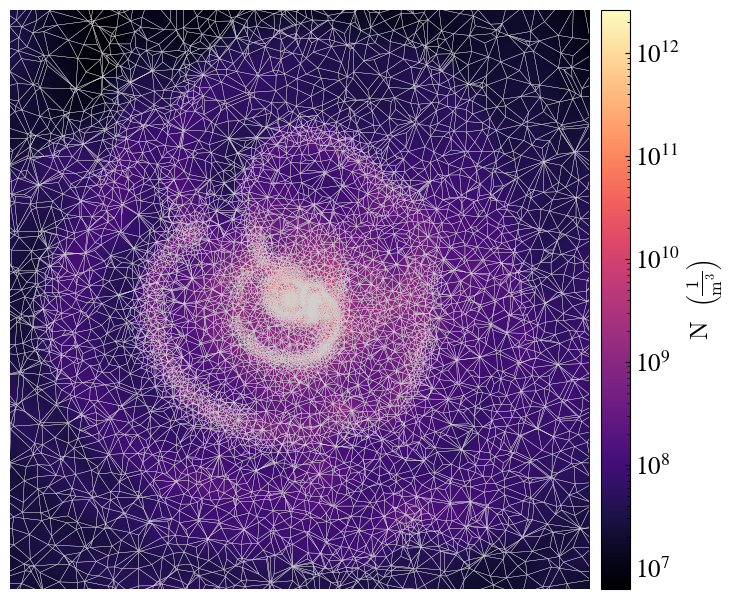

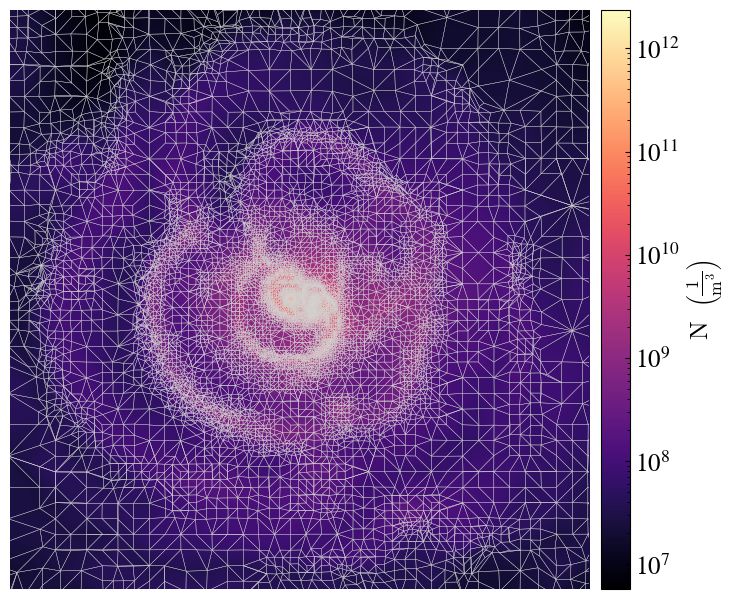

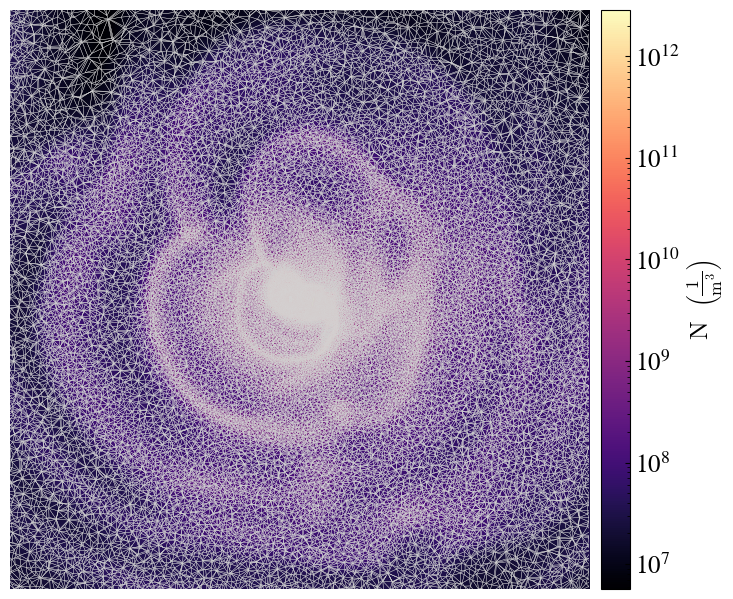

In [40]:
import matplotlib.colorbar
from palettable.cubehelix import cubehelix2_16 #same colorbar as intensities

zoom = 1.8
colorbarwidth = 0.2
lineprofileheight = 0.5
# velocitylabelheight = 0.1
# fig = plt.figure(1, figsize=(2*(4+lineprofileheight), 2*(3+colorbarwidth)), dpi=300)
fig = plt.figure(1, figsize=(2*(3+colorbarwidth), 2*(3+lineprofileheight)), dpi=300)
sep = fig.subfigures(2,2, height_ratios=[3, lineprofileheight], width_ratios=[3,colorbarwidth], wspace=-0.15, hspace=0.00)
#for all the plots on the mesh
subaxs = sep[0,0].subplots(3,3, sharex=True, sharey=True)
cbars = sep[0,1].subplots(3,1)
lineprofs = sep[1,0].subplots(1,3, sharey=False)

extent = [midx-diffx/zoom, midx+diffx/zoom, midy-diffy/zoom, midy+diffy/zoom]
density_cmap = "magma"#'viridis'
intensity_cmap = cubehelix2_16.mpl_colormap
reldiff_cmap = 'Reds_r'


#top row: meshes
#Yt does not play nice with matplotlib by default, so I save the images as .png's and then load them again
nCO_reduced_gmsh = np.array(NLTE_model_gmsh.chemistry.species.abundance)[:,1]
ds_gmsh = yt.load_unstructured_mesh(
         connectivity = delaunay_gmsh.simplices.astype(np.int64),
         coordinates  = delaunay_gmsh.points.astype(np.float64), # yt expects cm not m
         node_data    = {('connect1', 'n'): nCO_reduced_gmsh[delaunay_gmsh.simplices].astype(np.float64)/yt.units.m**3},
         length_unit='m'
)

sl = yt.SlicePlot (ds_gmsh, 'z', ('connect1', 'n'))
sl.set_cmap       (('connect1', 'n'), density_cmap)
# sl.set_zlim(('connect1', 'n'), zmin=(1e+6, 'm**(-3)'), zmax=(1e+12, 'm**(-3)'))
sl.zoom           (zoom)
sl.annotate_mesh_lines (plot_args={'color':'lightgrey', 'linewidths':[.25]})
sl.hide_axes()
sl.hide_colorbar()
# sl.save('gmsh_mesh.png')

mpl_fig_gmsh = sl.export_to_mpl_figure((1,1), label_mode="ALL", cbar_pad="2%", cbar_mode='each', cbar_location='right')

nCO_reduced_rec = np.array(NLTE_model_rec.chemistry.species.abundance)[:,1]
ds_gmsh = yt.load_unstructured_mesh(
         connectivity = delaunay_rec.simplices.astype(np.int64),
         coordinates  = delaunay_rec.points.astype(np.float64), # yt expects cm not m
         node_data    = {('connect1', 'n'): nCO_reduced_rec[delaunay_rec.simplices].astype(np.float64)/yt.units.m**3},
         length_unit='m'
)

sl = yt.SlicePlot (ds_gmsh, 'z', ('connect1', 'n'))
sl.set_cmap       (('connect1', 'n'), density_cmap)
# sl.set_zlim(('connect1', 'n'), zmin=(1e+6, 'm**(-3)'), zmax=(1e+12, 'm**(-3)'))
sl.zoom           (zoom)
sl.annotate_mesh_lines (plot_args={'color':'lightgrey', 'linewidths':[.25]})
sl.hide_axes()
sl.hide_colorbar()
# sl.save('rec_mesh.png')

mpl_fig_rec = sl.export_to_mpl_figure((1,1), label_mode="ALL", cbar_pad="2%", cbar_mode='each', cbar_location='right')

nCO_original = np.array(NLTE_model_original.chemistry.species.abundance)[:,1]
ds_gmsh = yt.load_unstructured_mesh(
         connectivity = delaunay_original.simplices.astype(np.int64),
         coordinates  = delaunay_original.points.astype(np.float64), # yt expects cm not m
         node_data    = {('connect1', 'n'): nCO_original[delaunay_original.simplices].astype(np.float64)/yt.units.m**3},
         length_unit='m'
)

mindensity = np.min([np.min(nCO_original), np.min(nCO_reduced_rec), np.min(nCO_reduced_gmsh)])
maxdensity = np.max([np.max(nCO_original), np.max(nCO_reduced_rec), np.max(nCO_reduced_gmsh)])
minco = np.min(nCO_original)
maxco = np.max(nCO_original)
#imread return values between 0-1, so rescale to original range

sl = yt.SlicePlot (ds_gmsh, 'z', ('connect1', 'n'))
sl.set_cmap       (('connect1', 'n'), density_cmap)
# sl.set_zlim(('connect1', 'n'), zmin=(1e+6, 'm**(-3)'), zmax=(1e+12, 'm**(-3)'))
sl.zoom           (zoom)
sl.annotate_mesh_lines (plot_args={'color':'lightgrey', 'linewidths':[.25]})
sl.hide_axes()
sl.hide_colorbar()
# sl.save('original_mesh.png')

mpl_fig_original = sl.export_to_mpl_figure((1,1), label_mode="ALL", cbar_pad="2%", cbar_mode='each', cbar_location='right')

meshdatagmsh = plt.imread('gmsh_mesh.png')
meshdatarec = plt.imread('rec_mesh.png')
meshdataoriginal = plt.imread('original_mesh.png')

# subaxs[0,0].title.set_text('Original mesh')
# subaxs[0,1].title.set_text('GMSH re-mesh')
# subaxs[0,2].title.set_text('Recursive re-mesh')

subaxs[0,0].title.set_text('Original')
subaxs[0,1].title.set_text('Reduced old')
subaxs[0,2].title.set_text('Reduced new')

subaxs[0,0].imshow(meshdataoriginal, extent=extent)
subaxs[0,1].imshow(meshdatagmsh, extent=extent)
subaxs[0,2].imshow(meshdatarec, extent=extent)

print("min", mindensity, "max", maxdensity, "minco", minco, "maxco", maxco)

#subaxs[0,0] = mpl_fig_original[0]
#subaxs[0,1] = mpl_fig_gmsh[0]
#subaxs[0,2] = mpl_fig_rec[0]

#density_colorbar = plt.colorbar(subaxs[0,0].images[0], cax=cbars[0], label = 'CO density (m$^{-3}$)')
density_colorbar = matplotlib.colorbar.ColorbarBase(cbars[0], orientation='vertical', cmap = density_cmap)
#manually convert 0-1 range to original log scale

logrange = np.log10(maxdensity)-np.log10(mindensity)
cbars[0].set_yticks([np.log10(1e7/mindensity)/logrange, np.log10(1e8/mindensity)/logrange, np.log10(1e9/mindensity)/logrange, np.log10(1e10/mindensity)/logrange, np.log10(1e11/mindensity)/logrange, np.log10(1e12/mindensity)/logrange])
cbars[0].set_yticklabels(['$10^7$', '$10^8$', '$10^9$', '$10^{10}$', '$10^{11}$', '$10^{12}$'])
cbars[0].set_ylabel('CO density [m$^{-3}$]')
#plt.colorbar(subaxs[0,0], cax=cbars[0], cmap = 'magma', label = 'CO density (m$^{-3}$)')
#TODO: correct labels and ticks, from labels given by later data
#We plot the relative differences and correct the ticks/labels of the yt imshow things

maxval = 1.0 #max(np.max(reldiff_image_original_rec), np.max(reldiff_image_original_gmsh))
minval = 1e-2#lower than this value would distort the plot
im_reldiff_gmsh = subaxs[2,1].imshow(reldiff_image_original_gmsh.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm(vmin=minval, vmax=maxval), cmap = reldiff_cmap)
# subaxs[2,1].invert_yaxis()#y axis is wrong
subaxs[2,1].set_xlim([midx-diffx/zoom, midx+diffx/zoom])
subaxs[2,1].set_ylim([midy-diffy/zoom, midy+diffy/zoom])
subaxs[2,2].imshow(reldiff_image_original_rec.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm(vmin=minval, vmax=maxval), cmap = reldiff_cmap)
# subaxs[2,2].invert_yaxis()#y axis is wrong
subaxs[2,2].set_xlim([midx-diffx/zoom, midx+diffx/zoom])
subaxs[2,2].set_ylim([midy-diffy/zoom, midy+diffy/zoom])
reldiff_colorbar = plt.colorbar(im_reldiff_gmsh, cbars[2], subaxs[2,1], label = 'Relative difference')
#and remove the empty plot
subaxs[2,0].axis('off')

#Now we plot the zero velocity channel maps
im_I_original = subaxs[1,0].imshow(I_original.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm(), cmap = intensity_cmap)
subaxs[1,0].set_xlim([midx-diffx/zoom, midx+diffx/zoom])
subaxs[1,0].set_ylim([midy-diffy/zoom, midy+diffy/zoom])
subaxs[1,1].imshow(I_gmsh.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm(), cmap = intensity_cmap)
subaxs[1,1].set_xlim([midx-diffx/zoom, midx+diffx/zoom])
subaxs[1,1].set_ylim([midy-diffy/zoom, midy+diffy/zoom])
subaxs[1,2].imshow(I_rec.reshape(Nx, Ny, 121)[:,:,60].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm(), cmap = intensity_cmap)
subaxs[1,2].set_xlim([midx-diffx/zoom, midx+diffx/zoom])
subaxs[1,2].set_ylim([midy-diffy/zoom, midy+diffy/zoom])
# intensity_colorbar =plt.colorbar(im_I_original, cbars[1], subaxs[1,0], label = 'Intensity [W m$^{-2}$ sr$^{-1}$ Hz$^{-1}$]')
intensity_colorbar = plt.colorbar(im_I_original, cbars[1], subaxs[1,0], label = 'Intensity (SI)')

#And finally also plot the resulting line profiles
lineprofs[0].plot(velos, Is_original_norm, color="black")
# lineprofs[1].plot(velos, Is_gmsh_norm)
# lineprofs[2].plot(velos, Is_rec_norm)
# lineprofs[0].set_xlabel("Velocity [km/s]")
lineprofs[0].set_ylabel("Relative intensity [.]")
sep[1,0].supxlabel("Velocity [km/s]", y=-0.4, fontsize="medium")
# sep[1,0].supylabel("Relative intensity [.]")
# Finally, also plot the original line profile on the others
# lineprofs[1].plot(velos, Is_original_norm, label='Original', linestyle='--', color='black', alpha=0.5)
# lineprofs[2].plot(velos, Is_original_norm, label='Original', linestyle='--', color='black', alpha=0.5)
# Err, never mind, need to plot the relative differences of the line profiles instead
lineprofs[2].set_ylabel("Relative difference [.]")
lineprofs[2].yaxis.set_label_position("right")
lineprofs[1].yaxis.tick_right()
lineprofs[2].yaxis.tick_right()
lineprofs[1].set_ylim(-0.1, 0.1)
lineprofs[1].tick_params(axis='y', labelright = False)
lineprofs[2].set_ylim(-0.1, 0.1)
lineprofs[1].plot(velos, 2.0*(Is_gmsh_norm-Is_original_norm)/(Is_gmsh_norm+Is_original_norm), label='GMSH', color='red')
lineprofs[1].hlines(0, velos[0], velos[-1], color='black', linestyle='--', linewidth=0.5)
lineprofs[2].plot(velos, 2.0*(Is_rec_norm-Is_original_norm)/(Is_rec_norm+Is_original_norm), label='Recursive', color='red')
lineprofs[2].hlines(0, velos[0], velos[-1], color='black', linestyle='--', linewidth=0.5)


#for some reason, the y-axis labels are flipped; might have something to do with me saving and reading the slice plots of the meshes
# So I'll just manually reverse them
yticks = subaxs[0,0].get_yticks().astype(np.int32)#
subaxs[0,0].set_yticklabels(yticks[::-1])
# subaxs[3,0].plot
# subaxs[3,1].plot(velos, Is_gmsh_norm, label='GMSH')
# plt.plot(velos, Is_rec_norm, label='Recursive')
# plt.plot(velos, Is_original_norm, label='Original')




sep[0,0].supxlabel('X [AU]', fontsize="medium")
sep[0,0].supylabel('Y [AU]', fontsize="medium")

fig.show()
fig.savefig("Images/combined_plot_meshes_and_diffs.pdf", bbox_inches='tight', dpi=300)
# plt.show()

Also plot the relative differences of the corresponding channel maps

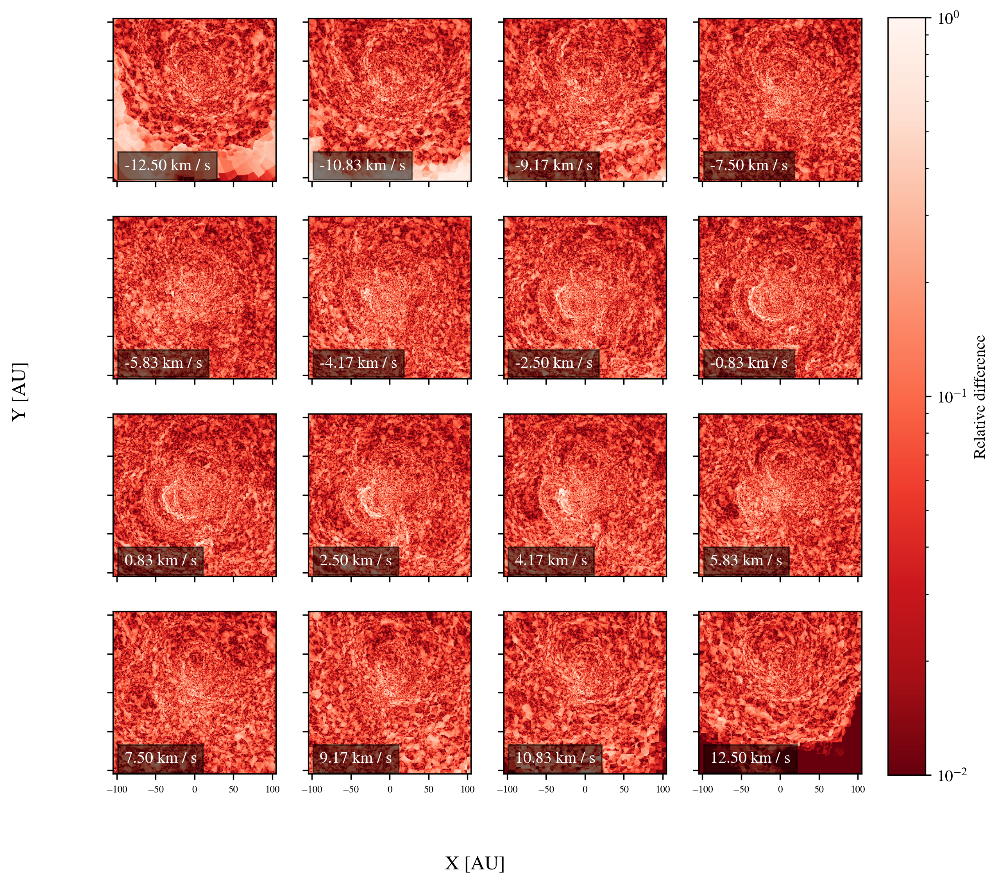

In [38]:
#rel diff gmsh original
colorbarwidth = 0.2
zoom = 1.8
fig = plt.figure(figsize=(2*4,2*(4+colorbarwidth)), dpi=300)
sep = fig.subfigures(1,2, width_ratios=[4, colorbarwidth], wspace=-0.15)
channels = [30+4*i for i in range(16)]

subaxs = sep[0].subplots(4,4, sharex=True, sharey=True)
freqs = np.array(NLTE_model_gmsh.images[-1].freqs)
f_ij  = np.mean(freqs)
v_unit = units.km / units.s
velos = (freqs - f_ij) / f_ij * constants.c.to(v_unit).value
idx = 0
idy = 0
for channel in channels:
    im_reldiff = subaxs[idy,idx].imshow(reldiff_image_original_gmsh.reshape(Nx, Ny, 121)[:,:,channel].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm(vmin=minval, vmax=maxval), cmap = reldiff_cmap)
    subaxs[idy,idx].invert_yaxis()#y axis is wrong
    #And the labels are also wrong
    yticks = subaxs[idy,idx].get_yticklabels()
    subaxs[idy,idx].set_yticklabels(yticks[::-1])#revrese the y-axis labels

    subaxs[idy,idx].set_xlim([midx-diffx/zoom, midx+diffx/zoom])
    subaxs[idy,idx].set_ylim([midy-diffy/zoom, midy+diffy/zoom])
    subaxs[idy,idx].tick_params(axis='both', which='both', labelsize=6)
    subaxs[idy,idx].text(0.07,0.07,f'{velos[channel]:.2f} '+str(v_unit), transform = subaxs[idy, idx].transAxes, color='white', bbox=dict(facecolor='black', alpha=0.5))

    idx+=1
    if idx == 4:
        idx = 0
        idy += 1


sep[0].supxlabel('X [AU]')
sep[0].supylabel('Y [AU]')

reldiff_colorbar = plt.colorbar(im_reldiff, sep[1].subplots(1,1), subaxs[0,0], label = 'Relative difference')
plt.savefig("Images/channel_maps_reldiff_gmsh_original.pdf", bbox_inches='tight', dpi=300)


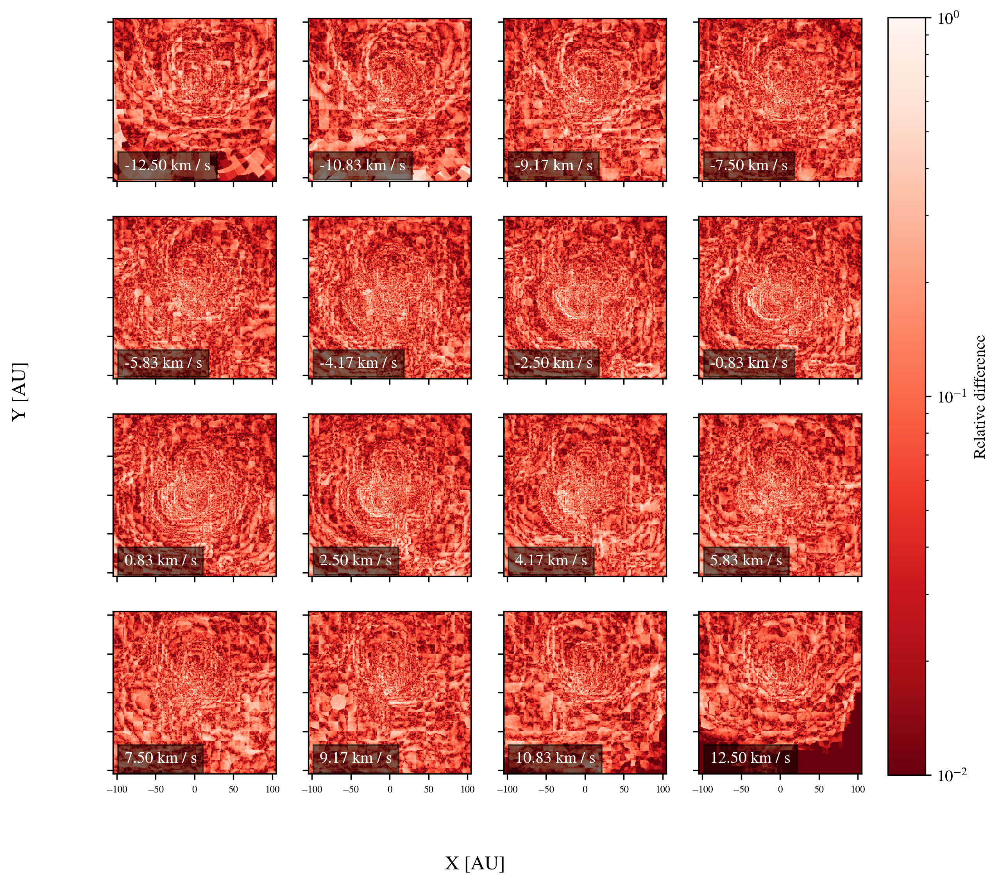

In [39]:
#rel diff rec original
colorbarwidth = 0.2
zoom = 1.8
fig = plt.figure(figsize=(2*4,2*(4+colorbarwidth)), dpi=300)
sep = fig.subfigures(1,2, width_ratios=[4, colorbarwidth], wspace=-0.15)
channels = [30+4*i for i in range(16)]

subaxs = sep[0].subplots(4,4, sharex=True, sharey=True)
freqs = np.array(NLTE_model_rec.images[-1].freqs)
f_ij  = np.mean(freqs)
v_unit = units.km / units.s
velos = (freqs - f_ij) / f_ij * constants.c.to(v_unit).value
idx = 0
idy = 0
for channel in channels:
    im_reldiff = subaxs[idy,idx].imshow(reldiff_image_original_rec.reshape(Nx, Ny, 121)[:,:,channel].T, extent=[min(posx), max(posx), min(posy), max(posy)]/au.value, norm=matplotlib.colors.LogNorm(vmin=minval, vmax=maxval), cmap = reldiff_cmap)
    subaxs[idy,idx].invert_yaxis()#y axis is wrong
    #And the labels are also wrong
    yticks = subaxs[idy,idx].get_yticklabels()
    subaxs[idy,idx].set_yticklabels(yticks[::-1])#revrese the y-axis labels

    subaxs[idy,idx].set_xlim([midx-diffx/zoom, midx+diffx/zoom])
    subaxs[idy,idx].set_ylim([midy-diffy/zoom, midy+diffy/zoom])
    subaxs[idy,idx].tick_params(axis='both', which='both', labelsize=6)
    subaxs[idy,idx].text(0.07,0.07,f'{velos[channel]:.2f} '+str(v_unit), transform = subaxs[idy, idx].transAxes, color='white', bbox=dict(facecolor='black', alpha=0.5))

    idx+=1
    if idx == 4:
        idx = 0
        idy += 1


sep[0].supxlabel('X [AU]')
sep[0].supylabel('Y [AU]')

reldiff_colorbar = plt.colorbar(im_reldiff, sep[1].subplots(1,1), subaxs[0,0], label = 'Relative difference')
plt.savefig("Images/channel_maps_reldiff_rec_original.pdf", bbox_inches='tight', dpi=300)